# Шулявка зі світлофором vs Шулявка з розв'язкою

$16$ березня $2019$ року Шулявський шляхопровід в Києві [почали](https://nv.ua/ukr/ukraine/events/budivnictvo-stolittya-v-kiyevi-shcho-potribno-znati-pro-remont-shulyavskogo-mostu-shemi-ob-jizdu-termini-50010495.html) демонтувати. Було запроваджено регульовані повороти з та на вулицю Гетьмана і більш ніж півроку цей вузол працював саме в такому режимі. Наскільки критичним було перекриття? Як сильно воно збільшило затримки на проспекті Перемоги та сусідніх вулицях? Відповісти на це питання можна проаналізувавши відкриті дані сервісу [Uber Movement](https://movement.uber.com/explore/kyiv/speeds/).

Але спочатку необхідно підготувати дані. Я скачав архіви за березень та квітень $2019$ року та побудувавши візуалізацію на мапі типу [цієї](#map_cell), але для всього Києва, переконався, що можна розглядати лише частину міста. Скажімо, інтуітивно ясно, що перекриття Шулявки не дуже вплинуло на лівий берег і я в цьому візуально переконався. Тож для економії пам'яті та часу і концентрації уваги на найважливішому, вибираємо лише ту частину даних, що відповідають достатньо близьким до Шулявки вулицям.

In [1]:
import pandas as pd
import numpy as np
import glob
import osmnx as ox
from shapely.geometry import Polygon

#частина Києва, що розглядатиметься, задається цим набором точок
area = Polygon([(30.5241, 50.4332), (30.5258, 50.4512), (30.5289, 50.4515), (30.5288, 50.4565),
                (30.5262, 50.4673), (30.5362, 50.4738), (30.5411, 50.4833), (30.5307, 50.4908), 
                (30.4754, 50.4897), (30.4529, 50.4817), (30.4465, 50.4751), (30.4335, 50.4774), 
                (30.3634, 50.5001), (30.3494, 50.4671), (30.2406, 50.463), (30.2423, 50.4435), 
                (30.349, 50.4494), (30.3604, 50.423), (30.4102, 50.387), (30.4405, 50.4251), 
                (30.4927, 50.4065), (30.5205, 50.404), (30.5291, 50.4095), (30.5245, 50.4198)])
streets = ox.core.osm_net_download(polygon = area, network_type = 'all_private')[0]['elements']

streets_ids = []
for row in streets:
    if row['type'] == 'node':
        streets_ids.append(row['id'])

dtypes = {'year': np.int16, 'month': np.int8, 'day': np.int8, 'hour': np.int8, 
          'osm_start_node_id': np.int64, 'osm_end_node_id': np.int64, 
          'speed_kph_mean': np.float16, 'speed_kph_stddev': np.float16}

#під час фільтрування даних для зручності створимо новий стовпчик з датою
def datetime_from_ymd(daterow):
    return pd.to_datetime(str(int(daterow['year'])) + '/' +\
                          str(int(daterow['month'])) + '/' + str(int(daterow['day'])))

#функція, яка відфільтровує непотрібні нам записи та зберігає результат, працює довго
def create_Shuliavka_csv():
    filename, tp = 'movement-speeds-hourly-kyiv-2019', []
    for f in glob.glob(filename + '*.csv'):
        for chunk in pd.read_csv(f, chunksize = 100000, low_memory = False, 
                                 usecols = dtypes.keys(), dtype = dtypes):
            newchunk = chunk[(chunk['osm_start_node_id'].isin(streets_ids)) &
                             (chunk['osm_end_node_id'].isin(streets_ids)) &
                             ((chunk['month'] == 3) | (chunk['month'] == 4) & 
                              (chunk['day'] < 6))]
            newchunk['date'] = newchunk.apply(lambda row: datetime_from_ymd(row), axis = 1)
            tp.append(newchunk)
            
    tp_data = pd.concat(tp)
    tp_data.to_csv('movement-speeds-for-Shuliavka.csv')
    del(tp)
    del(tp_data)
    return 0

#підвантажуємо вже відфільтрований .csv-файл, він все одно доволі великий
tp = []
for chunk in pd.read_csv('movement-speeds-for-Shuliavka.csv', dtype = dtypes, 
                         parse_dates = ['date'], chunksize = 100000, low_memory = False):
    tp.append(chunk)

data = pd.concat(tp)
data.drop('Unnamed: 0', axis = 1)
del(tp)

## Вплив перекриття на трафік на проспекті Перемоги

Спершу розглянемо по два тижні до та після перекриття Шулявки:

In [2]:
#робочі та вихідні дні в потрібному інтервалі (8 березня доводиться видаляти вручну)
workdays_before = pd.bdate_range('2019-03-01', '2019-03-15').to_series().drop(labels = [pd.to_datetime('2019-03-08')])   
weekends_before = pd.date_range('2019-03-01', '2019-03-15').to_series().drop(\
                  pd.bdate_range('2019-03-01', '2019-03-15').to_series())
workdays_after = pd.bdate_range('2019-03-18', '2019-03-31').to_series()
weekends_after = pd.date_range('2019-03-18', '2019-03-31').to_series().drop(\
                 pd.bdate_range('2019-03-18', '2019-03-31').to_series())

In [3]:
import matplotlib.pyplot as plt
import matplotlib
from matplotlib import cm
%matplotlib inline
matplotlib.rcParams['figure.figsize'] = [14, 8]
plt.style.use('seaborn-darkgrid')
plt.rcParams.update({'font.size': 14})

def plotting(ax, days, longitudes, days_speeds, colors):
    for j, day in enumerate(days):
        sort_by_lon = {k: v for k, v in sorted(longitudes.items(), key = lambda item: item[1])}
        ax.plot(list(sort_by_lon.values()), \
                 [days_speeds[day][int(i)] for i in sort_by_lon.keys()], color = colors[j])

In [4]:
from collections import defaultdict

def Peremohy_longitudes_latitudes():
    Peremohy_lons, Peremohy_lats, Peremohy_nodes = {}, {}, []
    for entry in streets:
        if (entry['type'] == 'way' and 'name' in entry['tags'].keys() and\
            'Перемоги проспект' == entry['tags']['name']):
            Peremohy_nodes += entry['nodes']

    for entry in streets:
        if (entry['type'] == 'node' and entry['id'] in Peremohy_nodes):
            Peremohy_lons[entry['id']] = entry['lon']
            Peremohy_lats[entry['id']] = entry['lat']
            
    return Peremohy_lons, Peremohy_lats

def Peremohy_plot(ax, days, colors, Peremohy_lons):
    Peremohy_to_center, Peremohy_days_speeds = {}, defaultdict(dict)
    
    for _, speeddata in data.loc[data['hour'] == 8].iterrows():
        #передостання умова тут - вибір напрямку в бік центру
        if speeddata['osm_start_node_id'] in Peremohy_lons.keys() and \
        speeddata['osm_end_node_id'] in Peremohy_lons.keys() and \
        Peremohy_lons[speeddata['osm_end_node_id']] > Peremohy_lons[speeddata['osm_start_node_id']] and\
        speeddata['date'] in days:
            Peremohy_to_center[speeddata['osm_start_node_id']] = (Peremohy_lons[speeddata['osm_start_node_id']] + \
            Peremohy_lons[speeddata['osm_end_node_id']]) / 2
            Peremohy_days_speeds[speeddata['date']][speeddata['osm_start_node_id']] = speeddata['speed_kph_mean']

    #може статись так, що невелика частина швидкостей відсутня, заповнимо їх найближчим наявним значенням
    #вважається, що в перший день всі швидкості є
    for i, day in enumerate(days):
        for key in Peremohy_to_center.keys():
            if not int(key) in Peremohy_days_speeds[day]:
                Peremohy_days_speeds[day][key] = Peremohy_days_speeds[days[i - 1]][key]

    plotting(ax, days, Peremohy_to_center, Peremohy_days_speeds, colors)

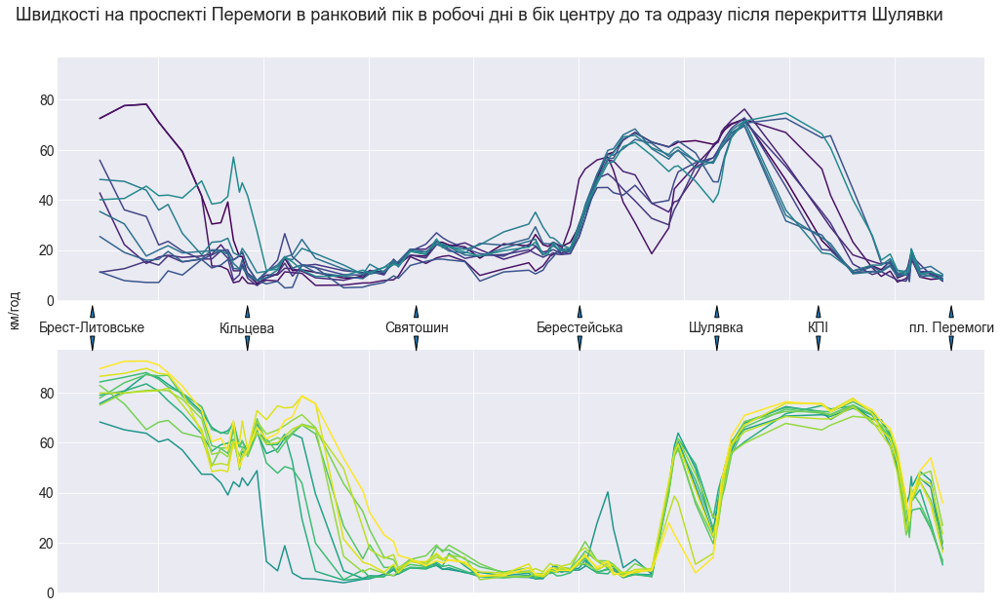

In [5]:
fig, ax = plt.subplots(2, sharex = 'col', sharey = True, figsize = (16, 9))

colors = cm.viridis(np.linspace(0, 1, len(workdays_before) + len(workdays_after)))
Peremohy_longs = Peremohy_longitudes_latitudes()[0]
Peremohy_plot(ax[0], workdays_before, colors[:len(workdays_before)], Peremohy_longs)
Peremohy_plot(ax[1], workdays_after, colors[len(workdays_before):], Peremohy_longs)

frame = plt.gca()
frame.axes.xaxis.set_ticklabels([])
annotations = {'Брест-Литовське': 30.32751, 'Кільцева': 30.357,
               'Святошин': 30.3891, 'Берестейська': 30.4202,
               'Шулявка': 30.44629, 'КПІ': 30.46559, 'пл. Перемоги': 30.49087 }
for name, longitude in annotations.items():
    plt.annotate(name, xy = (longitude, 0.50), xycoords = ('data', 'figure fraction'), 
                 xytext = (longitude, 0.46), ha = 'center', va = 'center', 
                 arrowprops = dict(arrowstyle = "wedge"), annotation_clip = False)
    plt.annotate('', xy = (longitude, 0.42), xycoords = ('data', 'figure fraction'), 
                 xytext = (longitude, 0.45), ha = 'center', va = 'center', 
                 arrowprops = dict(arrowstyle = "wedge"), annotation_clip = False)

matplotlib.pyplot.subplots_adjust(left = 0.125, bottom = 0.05, right = 0.95, top = 0.9, wspace = None, hspace = 0.2)
fig.suptitle('Швидкості на проспекті Перемоги в ранковий пік в робочі дні в бік центру до та одразу після перекриття Шулявки',
             fontsize = 18)
fig.text(0.08, 0.5, 'км/год', va = 'center', rotation = 'vertical')
plt.show()

Зображення зверху згенероване на основі даних о $8$ ранку в робочі дні між $01/03/2019$ та $15/03/2019$ включно, знизу - те ж саме в період між $18/03/2019$ та $31/03/2019$. Тут блакитний колір відповідає найближчим до $16$ березня датам. Цікаво бачити, наскільки більш передбачуваною швидкість потоку стала після встановлення світлофору. Також бачимо, що на нижньому зображенні швидкості в близькі до перекриття дні подекуди вибиваються з загального тренду. Справа в тому, що в перші дні після перекриття трафік "намацував" рівноважне положення. Не будемо розглядати перший тиждень після перекриття з цих міркувань.

In [6]:
#"зсуваємо" розглядуваний часовий проміжок "після" на тиждень вперед
workdays_after = pd.bdate_range('2019-03-23', '2019-04-05').to_series()
weekends_after = pd.date_range('2019-03-23', '2019-04-05').to_series().drop(\
                 pd.bdate_range('2019-03-23', '2019-04-05').to_series())

In [7]:
from geopy import distance

#час в хвилинах, за який відстань між точками долається зі швидкістю speed
def get_time(lon1, lat1, lon2, lat2, speed):
    return (60 * distance.distance((lat1, lon1), (lat2, lon2)).km) / speed

Peremohy_times = {'from_center_before': np.zeros(24), 'to_center_before': np.zeros(24),
                  'from_center_after': np.zeros(24), 'to_center_after': np.zeros(24)}
Peremohy_longs, Peremohy_lats = Peremohy_longitudes_latitudes()
Peremohy_data = data[(data['osm_start_node_id'].isin(Peremohy_longs.keys())) &
                     (data['osm_end_node_id'].isin(Peremohy_longs.keys()))]

#функція що обробляє один рядок, заповнюючи словник temp
def from_row_to_temp(speeddata, longs, lats, temp):
    if longs[speeddata['osm_end_node_id']]\
    > longs[speeddata['osm_start_node_id']]:
        temp['to'][(speeddata['osm_start_node_id'], speeddata['osm_end_node_id'])].\
        append(get_time(longs[speeddata['osm_end_node_id']],
                        lats[speeddata['osm_end_node_id']], 
                        longs[speeddata['osm_start_node_id']],
                        lats[speeddata['osm_start_node_id']],
                        speeddata['speed_kph_mean']))
    else:
        temp['from'][(speeddata['osm_start_node_id'], speeddata['osm_end_node_id'])].\
        append(get_time(longs[speeddata['osm_end_node_id']],
                        lats[speeddata['osm_end_node_id']], 
                        longs[speeddata['osm_start_node_id']],
                        lats[speeddata['osm_start_node_id']],
                        speeddata['speed_kph_mean']))
    return

for hour in range(24):
    temp_before = {'to': defaultdict(list), 'from': defaultdict(list)}
    temp_after = {'to': defaultdict(list), 'from': defaultdict(list)}
    
    for _, speeddata in Peremohy_data[(Peremohy_data['date'].isin(workdays_before))\
                                      & (Peremohy_data['hour'] == hour)].iterrows():
        from_row_to_temp(speeddata, Peremohy_longs, Peremohy_lats, temp_before)
    for _, speeddata in Peremohy_data[(Peremohy_data['date'].isin(workdays_after))\
                                      & (Peremohy_data['hour'] == hour)].iterrows():
        from_row_to_temp(speeddata, Peremohy_longs, Peremohy_lats, temp_after)

    Peremohy_times['to_center_before'][hour] = sum([np.mean(v) for v in temp_before['to'].values()])
    Peremohy_times['from_center_before'][hour] = sum([np.mean(v) for v in temp_before['from'].values()])
    Peremohy_times['to_center_after'][hour] = sum([np.mean(v) for v in temp_after['to'].values()])
    Peremohy_times['from_center_after'][hour] = sum([np.mean(v) for v in temp_after['from'].values()])

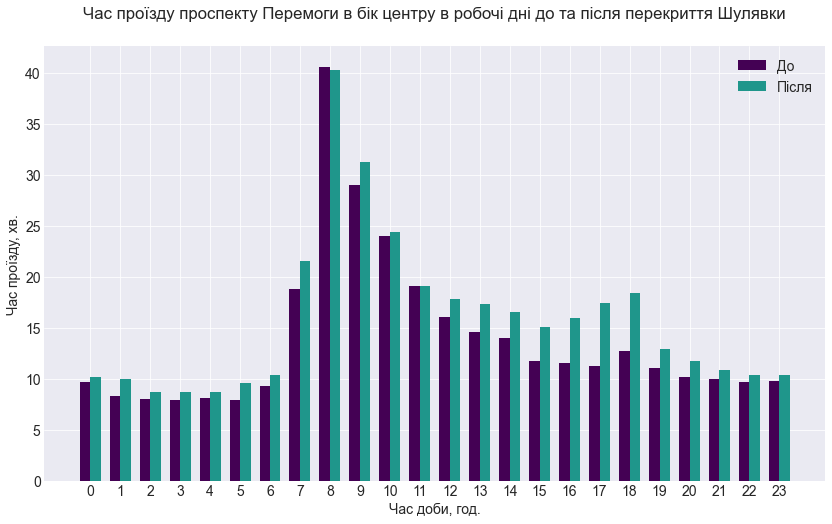

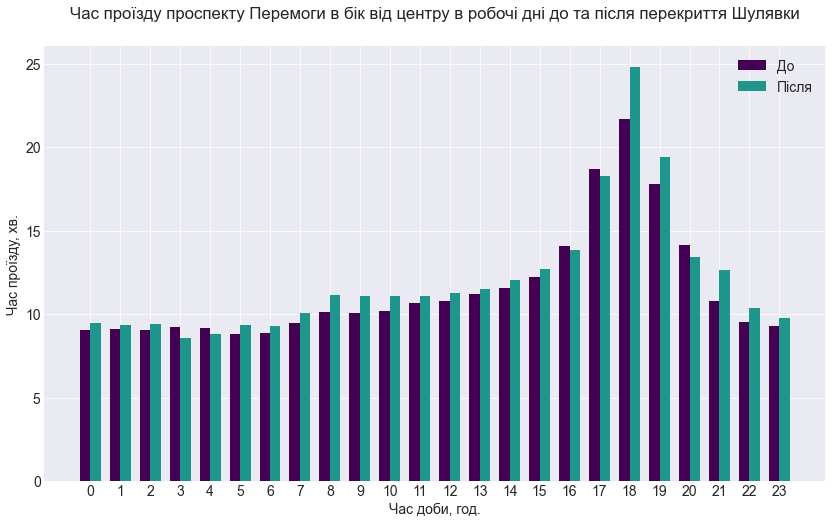

In [8]:
width = 0.35
x = np.arange(24)

def plot_before_and_after(before, after, title):
    plt.bar(x - width / 2, before, width, label = 'До', color = colors[0])
    plt.bar(x + width / 2, after, width, label = 'Після', color = colors[len(workdays_before)])
    
    plt.xticks(x)
    plt.ylabel('Час проїзду, хв.')
    plt.xlabel('Час доби, год.')
    plt.legend()
    plt.title(title, y = 1.05)
    plt.show()

plot_before_and_after(Peremohy_times['to_center_before'], Peremohy_times['to_center_after'], 
                      'Час проїзду проспекту Перемоги в бік центру в робочі дні до та після перекриття Шулявки')

plot_before_and_after(Peremohy_times['from_center_before'], Peremohy_times['from_center_after'], 
                      'Час проїзду проспекту Перемоги в бік від центру в робочі дні до та після перекриття Шулявки')

Можна було б очікувати, що в найзавантаженіші $8$ ранку регульоване перехрестя дасть найгіршу затримку в порівнянні з розв'язкою, але сталось навпаки. Ймовірно, частина людей змінили свої маршрути, спосіб пересування або час виїзду. Взагалі, світлофор збільшив час проїзду проспекту Перемоги, але найсуперечливі результати виходять саме в "основний" пік (вечірній у випадку "від центру" і враннішній "до центру). Складається враження, що найкраще розв'язка в різних рівнях працює саме коли трафік не є дуже щільним. Відчутнішим став вечірній пік по напрямку в бік центру і враннішній в бік від центру.

## Вплив на трафік на сусідніх вулицях

Звичайно, зміна організації руху на Шулявці вплинула на інші вулиці, насамперед – на вулиці Гетьмана, Довженка та інші частини "Малої Кільцевої". Подивимось, як саме:

In [11]:
import folium
from shapely.geometry import Point, LineString
from geopandas import GeoDataFrame
import branca

def to_lon_lat(node_id):
    for street in streets:
        if street['type'] == 'node' and street['id'] == int(node_id):
            return street['lon'], street['lat']
    return 0

tags_to_weights = {'trunk': 5, 'primary': 5, 'trunk_link': 5, 'primary_link': 4,
                   'secondary': 3, 'tertiary': 2, 'secondary_link': 2}

def weight_from_highway_tag(tag):
    if tag in tags_to_weights.keys():
        return tags_to_weights[tag]
    return 1

def get_speeds_geom(hour):
    speeds_before, speeds_after = defaultdict(list), defaultdict(list)
    for _, speeddata in data.loc[(data['hour'] == hour) & (data['date'].isin(workdays_before))].iterrows():
        speeds_before[(speeddata['osm_start_node_id'], speeddata['osm_end_node_id'])].\
        append(speeddata['speed_kph_mean'])
    for _, speeddata in data.loc[(data['hour'] == hour) & (data['date'].isin(workdays_after))].iterrows():
        speeds_after[(speeddata['osm_start_node_id'], speeddata['osm_end_node_id'])].\
        append(speeddata['speed_kph_mean'])
        
    highway_tags, geometries, street_names = defaultdict(int), defaultdict(list), defaultdict(str) 
    speeds_before_keys = speeds_before.keys()
    for street in streets:
        if street['type'] == 'way':
            nodes = street['nodes']
            for i in range(len(nodes)):
                for j in range(i + 1, len(nodes)):
                    key = (nodes[i], nodes[j])
                    if key in speeds_before_keys or key in speeds_before_keys:
                        if highway_tags[key] == 0 or\
                        weight_from_highway_tag(street['tags']['highway'])\
                        > weight_from_highway_tag(highway_tags[key]):
                            highway_tags[key] = street['tags']['highway']
                            geometries[key] = nodes[i: j + 1]
                        if 'name' in street['tags'].keys():
                            street_names[key] = street['tags']['name']
    
    return speeds_before, speeds_after, highway_tags, geometries, street_names

maxpercent, minpercent = 0.5, -0.5
colormap = branca.colormap.LinearColormap(colors = ['red', 'yellow', 'green'], 
                                          vmin = minpercent * 100, vmax = maxpercent * 100)
colormap.caption = '%'

def style(x):
    return {'color': colormap(x['properties']['percent'] * 100), 'weight': x['properties']['w']}

def get_map(hour):
    speeds_before, speeds_after, highway_tags, geometries, street_names = get_speeds_geom(hour)
    percent, lines, weights, captions, spd_before, spd_after = [], [], [], [], [], []
    for key in speeds_before.keys():
        if len(speeds_before[key]) > 0 and len(speeds_after[key]) > 0:
            if len(geometries[key]) > 0:
                lines.append(LineString([to_lon_lat(node_id) for node_id in geometries[key]]))
            else:
                lines.append(LineString([to_lon_lat(key[0]), to_lon_lat(key[1])]))
            spd_before.append(np.mean(speeds_before[key]))
            spd_after.append(np.mean(speeds_after[key]))
            percent.append((spd_after[-1] - spd_before[-1]) / spd_before[-1])
            weights.append(weight_from_highway_tag(highway_tags[key]))
            captions.append(street_names[key])

    geodf = pd.concat([GeoDataFrame(None, geometry = lines), 
                       pd.DataFrame(list(zip(percent, weights, spd_after, 
                                             spd_before, captions)), 
                                    columns = ['percent', 'w', "Швидкість після перекриття, км/год:",
                                               "Швидкість до перекриття, км/год:", "Вулиця:"])], axis = 1)
    geodf.crs = 'epsg:4326'

    map_speed = folium.Map([50.45457, 30.44592], zoom_start = 13, tiles = 'Cartodb Positron')
    folium.GeoJson(geodf, style_function = lambda x: style(x),
                   popup = folium.GeoJsonPopup(fields = ["Вулиця:", "Швидкість до перекриття, км/год:", 
                                                         "Швидкість після перекриття, км/год:"])).add_to(map_speed)
    colormap.add_to(map_speed)
    
    return map_speed

Наступні мапи показують, наскільки збільшилась або зменшилась швидкість на дорогах в будні після перекриття Шулявки. На всіх мапах можна клікати на відрізки доріг щоб подивитись детальну інформацію про швидкості. Перша мапа - ранковий пік ($8$ ранку):

<a id = 'map_cell'></a>

In [12]:
get_map(8)

Окрім очікуваної затримки на Перемоги, бачимо "пляшкові горла" в напрямку до центру на вулицях Дегтярівській, Стеценка/Щусєва, Сікорського та Повітрофлотському проспекті. В той же час, сильно розвантажилась "Мала Кільцева" (звісно, окрім відрізку на Шулявці) і відповідно в'їзди на неї. Дещо виросла швидкість в центрі міста, ймовірно, саме завдяки цьому швидше стали їхати деякі вулиці, що туди ведуть: Велика Васильківська, Набережно-Хрещатицька та (можливо, дещо несподівано) Борщагівська.

Далі - міжпік (друга година в робочі дні):

In [14]:
get_map(14)

В цілому схожа на минулу мапа, хоча проблем на в'їздах в центрах вже не видно.

Вечірній пік ($6$ година): 

In [13]:
get_map(18)

Тепер вже набагато повільніше їдуть виїзди з центру на Повітрофлотському (біля Севастопольської площі), Борщагівській (біля Індустріального мосту), Дегтярівській, Стеценка, Новокостянтинівській, Грушевського, Набережному шосе та Набережно-Луговій. Дуже помітно пришвидшився рух центром, знову швидше їде "Мала Кільцева". На більшості довжини пришвидшилась Кільцева.

## Висновки

1) Звісно, якщо зменшити пропускну здатність одного вузла, ми не побачимо більші затримки по всьому місту. Це так просто не працює. Люди змінюватимуть маршрут та спосіб пересування, потоки перерозподілятимуться. Ефект кожного великого транспортного проекту має аналізуватися перед його реалізацією.

2) Оскільки нова Шулявська розв'язка ідентична старій, наше порівняння можна вважати порівнянням нової Шулявської розв'язки та світлофорного перехрестя. І результати є суперечливими (особливо якщо при порівнянні врахувати вартість, зручність для інших користувачів міста та екологічні наслідки). Але, на жаль, за відсутності даних про кількість людей, що пересувались тими чи іншими відрзіками дорожньої мережі, остаточного висновку зробити поки не вдасться. Також не варто забувати, що цей аналіз концентрувався на конкретному моменті часу і не міг врахувати перспективний стан справ в місті.

Дякую за увагу!